# Preprocessing / Cleaning


In [2]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta

In [3]:
import matplotlib.pyplot as plt
import sklearn.linear_model

In [4]:
from google.colab import files

In [36]:
#I created a state key so every state has a numeric number so I didnt have to deal with categorical

<font color=skyblue>
Updated all files so that each state had a numeric number to match
</font>

# Accident Reports 2023

In [5]:
files.upload()

Saving accident.csv to accident.csv


{'accident.csv': b'STATE,STATENAME,ST_CASE,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,COUNTY,COUNTYNAME,CITY,CITYNAME,MONTH,MONTHNAME,DAY,DAYNAME,DAY_WEEK,DAY_WEEKNAME,YEAR,HOUR,HOURNAME,MINUTE,MINUTENAME,TWAY_ID,TWAY_ID2,ROUTE,ROUTENAME,RUR_URB,RUR_URBNAME,FUNC_SYS,FUNC_SYSNAME,RD_OWNER,RD_OWNERNAME,NHS,NHSNAME,SP_JUR,SP_JURNAME,MILEPT,MILEPTNAME,LATITUDE,LATITUDENAME,LONGITUD,LONGITUDNAME,HARM_EV,HARM_EVNAME,MAN_COLL,MAN_COLLNAME,RELJCT1,RELJCT1NAME,RELJCT2,RELJCT2NAME,TYP_INT,TYP_INTNAME,REL_ROAD,REL_ROADNAME,WRK_ZONE,WRK_ZONENAME,LGT_COND,LGT_CONDNAME,WEATHER,WEATHERNAME,SCH_BUS,SCH_BUSNAME,RAIL,RAILNAME,NOT_HOUR,NOT_HOURNAME,NOT_MIN,NOT_MINNAME,ARR_HOUR,ARR_HOURNAME,ARR_MIN,ARR_MINNAME,HOSP_HR,HOSP_HRNAME,HOSP_MN,HOSP_MNNAME,FATALS\n1,Alabama,10001,0,0,1,1,0,1,1,13,BUTLER (13),0,NOT APPLICABLE,1,January,4,4,4,Wednesday,2023,22,10:00pm-10:59pm,20,20,US-31 SR-3,,2,U.S. Highway,1,Rural,5,Major Collector,1,State Highway Agency,0,This Section IS NOT on the NHS,0,No Spec

In [27]:
accidents = pd.read_csv('accident.csv')
accidents

,STATE,STATENAME,ST_CASE,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,...,NOT_MINNAME,ARR_HOUR,ARR_HOURNAME,ARR_MIN,ARR_MINNAME,HOSP_HR,HOSP_HRNAME,HOSP_MN,HOSP_MNNAME,FATALS
0,1,Alabama,10001,0,0,1,1,0,1,1,...,20,22,10:00pm-10:59pm,45,45,88,Not Applicable (Not Transported),88,Not Applicable (Not Transported),1
1,1,Alabama,10002,0,0,1,1,0,1,1,...,8,2,2:00am-2:59am,23,23,88,Not Applicable (Not Transported),88,Not Applicable (Not Transported),1
2,1,Alabama,10003,0,0,1,1,0,1,1,...,48,23,11:00pm-11:59pm,8,8,88,Not Applicable (Not Transported),88,Not Applicable (Not Transported),1
3,1,Alabama,10004,0,0,1,1,0,3,3,...,0,19,7:00pm-7:59pm,44,44,99,Unknown,99,Unknown EMS Hospital Arrival Time,1
4,1,Alabama,10005,0,0,1,1,0,4,4,...,53,15,3:00pm-3:59pm,8,8,99,Unknown,99,Unknown EMS Hospital Arrival Time,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37649,56,Wyoming,560117,0,0,5,5,0,6,6,...,34,20,8:00pm-8:59pm,16,16,21,9:00pm-9:59pm,57,57,1
37650,56,Wyoming,560118,0,0,1,1,0,1,1,...,Unknown if Notified,99,Unknown EMS Scene Arrival Hour,98,Unknown if Arrived,88,Not Applicable (Not Transported),88,Not Applicable (Not Transported),1
37651,56,Wyoming,560119,1,1,1,1,0,1,1,...,Unknown if Notified,99,Unknown EMS Scene Arrival Hour,98,Unknown if Arrived,88,Not Applicable (Not Transported),88,Not Applicable (Not Transported),1
37652,56,Wyoming,560120,0,0,2,2,0,6,6,...,43,9,9:00am-9:59am,1,1,9,9:00am-9:59am,37,37,1


In [28]:
unique_values = accidents['STATE'].unique()
len(unique_values)

51

In [30]:
accidents.describe()

,STATE,ST_CASE,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,COUNTY,...,LGT_COND,WEATHER,SCH_BUS,NOT_HOUR,NOT_MIN,ARR_HOUR,ARR_MIN,HOSP_HR,HOSP_MN,FATALS
count,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,...,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000
mean,27.304350,273893.087375,0.246640,0.258751,1.588809,1.548813,0.039996,2.207282,2.195172,92.568837,...,1.982286,6.082116,0.003081,58.696925,68.086339,60.323259,69.367690,76.548282,80.071493,1.086233
std,16.490819,164823.148700,0.492486,0.523579,0.842440,0.803674,0.282445,1.691668,1.684175,98.855373,...,1.215709,18.709699,0.055419,43.164030,36.384085,43.005261,36.158108,33.463910,28.068737,0.353643
min,1.000000,10001.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,...,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,12.000000,121977.500000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,31.000000,...,1.000000,1.000000,0.000000,15.000000,33.000000,15.000000,35.000000,88.000000,88.000000,1.000000
50%,27.000000,270059.500000,0.000000,0.000000,1.000000,1.000000,0.000000,2.000000,2.000000,71.000000,...,2.000000,1.000000,0.000000,99.000000,98.000000,99.000000,98.000000,88.000000,88.000000,1.000000
75%,42.000000,420770.750000,0.000000,0.000000,2.000000,2.000000,0.000000,3.000000,3.000000,115.000000,...,3.000000,2.000000,0.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,1.000000
max,56.000000,560121.000000,19.000000,19.000000,35.000000,35.000000,9.000000,52.000000,52.000000,999.000000,...,9.000000,99.000000,1.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,8.000000


In [24]:
accidents['STATE'].mode()

,STATE
0,48


<font color=skyblue>Texas shows up the most on the accident reports. Its the second most populated state after California so the probability of an accident is much higher with a higher population. Although its a very large state. Texas also has higher poverty rate than the average state. </font>

<font color=skyblue>I want to clean this dataframe up even further. I have a lot of columns here that are irrelevant to my needs. I want to focus soley on State as thats the only information I have from the other datasets, so city and county don't mean to much and they are just causing noise.

1.   State Case number
2.   County
3.   City
4.   City Name
5.   Month Name (they have a numerical month column)
6.   Day Name (repeat of day)
7.   Year (its all 2023 for this project)

There are 80 rows in this dataset. I could go through them all but I fear that would be a waste of time. I am going to create a new excel sheet without the specific columns. I should still get the same numbers </font>



In [39]:
files.upload()

Saving newdf_accident.csv to newdf_accident.csv


{'newdf_accident.csv': b'STATE,STATENAME,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,MONTH,DAY,DAY_WEEK,ROUTE,ROUTENAME,RUR_URB,RUR_URBNAME,FUNC_SYS,FUNC_SYSNAME,RD_OWNER,RD_OWNERNAME,HARM_EV,HARM_EVNAME,MAN_COLL,MAN_COLLNAME,WRK_ZONE,WRK_ZONENAME,LGT_COND,LGT_CONDNAME,WEATHER,WEATHERNAME,SCH_BUS,FATALS\r\n1,Alabama,0,0,1,1,0,1,1,1,4,4,2,U.S. Highway,1,Rural,5,Major Collector,1,State Highway Agency,1,Rollover/Overturn,0,The First Harmful Event was Not a Collision with a Motor Vehicle in Transport,0,None,2,Dark - Not Lighted,1,Clear,0,1\r\n1,Alabama,0,0,1,1,0,1,1,3,20,2,4,County,1,Rural,7,Local,2,County Highway Agency,42,Tree (Standing Only),0,The First Harmful Event was Not a Collision with a Motor Vehicle in Transport,0,None,2,Dark - Not Lighted,1,Clear,0,1\r\n1,Alabama,0,0,1,1,0,1,1,3,18,7,4,County,1,Rural,5,Major Collector,2,County Highway Agency,35,Embankment,0,The First Harmful Event was Not a Collision with a Motor Vehicle in Transport,0,None,2,Dark - Not Lighted,1

In [42]:
accidents_2 = pd.read_csv('newdf_accident.csv')
accidents_2

,STATE,STATENAME,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,MONTH,...,MAN_COLL,MAN_COLLNAME,WRK_ZONE,WRK_ZONENAME,LGT_COND,LGT_CONDNAME,WEATHER,WEATHERNAME,SCH_BUS,FATALS
0,1,Alabama,0,0,1,1,0,1,1,1,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,2,Dark - Not Lighted,1,Clear,0,1
1,1,Alabama,0,0,1,1,0,1,1,3,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,2,Dark - Not Lighted,1,Clear,0,1
2,1,Alabama,0,0,1,1,0,1,1,3,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,2,Dark - Not Lighted,1,Clear,0,1
3,1,Alabama,0,0,1,1,0,3,3,3,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,2,Dark - Not Lighted,2,Rain,0,1
4,1,Alabama,0,0,1,1,0,4,4,3,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,1,Daylight,2,Rain,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37649,56,Wyoming,0,0,5,5,0,6,6,12,...,2,Front-to-Front,0,NaN,2,Dark - Not Lighted,11,Blowing Snow,0,1
37650,56,Wyoming,0,0,1,1,0,1,1,12,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,2,Dark - Not Lighted,1,Clear,0,1
37651,56,Wyoming,1,1,1,1,0,1,1,12,...,0,The First Harmful Event was Not a Collision wi...,0,NaN,1,Daylight,1,Clear,0,1
37652,56,Wyoming,0,0,2,2,0,6,6,12,...,6,Angle,0,NaN,1,Daylight,1,Clear,0,1


In [43]:
accidents_2.describe()

,STATE,PEDS,PERNOTMVIT,VE_TOTAL,VE_FORMS,PVH_INVL,PERSONS,PERMVIT,MONTH,DAY,...,RUR_URB,FUNC_SYS,RD_OWNER,HARM_EV,MAN_COLL,WRK_ZONE,LGT_COND,WEATHER,SCH_BUS,FATALS
count,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,...,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000,37654.000000
mean,27.304350,0.246640,0.258751,1.588809,1.548813,0.039996,2.207282,2.195172,6.707495,15.585356,...,1.646226,4.611728,12.893584,17.566500,1.966431,0.042917,1.982286,6.082116,0.003081,1.086233
std,16.490819,0.492486,0.523579,0.842440,0.803674,0.282445,1.691668,1.684175,3.369807,8.845323,...,0.707780,8.858681,30.519146,13.901025,6.071817,0.350385,1.215709,18.709699,0.055419,0.353643
min,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000
25%,12.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,4.000000,8.000000,...,1.000000,3.000000,1.000000,8.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000
50%,27.000000,0.000000,0.000000,1.000000,1.000000,0.000000,2.000000,2.000000,7.000000,16.000000,...,2.000000,4.000000,1.000000,12.000000,0.000000,0.000000,2.000000,1.000000,0.000000,1.000000
75%,42.000000,0.000000,0.000000,2.000000,2.000000,0.000000,3.000000,3.000000,10.000000,23.000000,...,2.000000,5.000000,4.000000,24.000000,2.000000,0.000000,3.000000,2.000000,0.000000,1.000000
max,56.000000,19.000000,19.000000,35.000000,35.000000,9.000000,52.000000,52.000000,12.000000,31.000000,...,9.000000,99.000000,99.000000,99.000000,99.000000,4.000000,9.000000,99.000000,1.000000,8.000000


In [46]:
accidents['STATE'].value_counts()

,count
STATE,
48,3874
6,3727
12,3183
13,1491
37,1449
47,1219
4,1195
39,1150
17,1143


Highest accidents occurin in Texas, California, and Florida

January and December were the highest months for fatalities

Weekend days Sat and Sun had the highest fatalities for days of the week

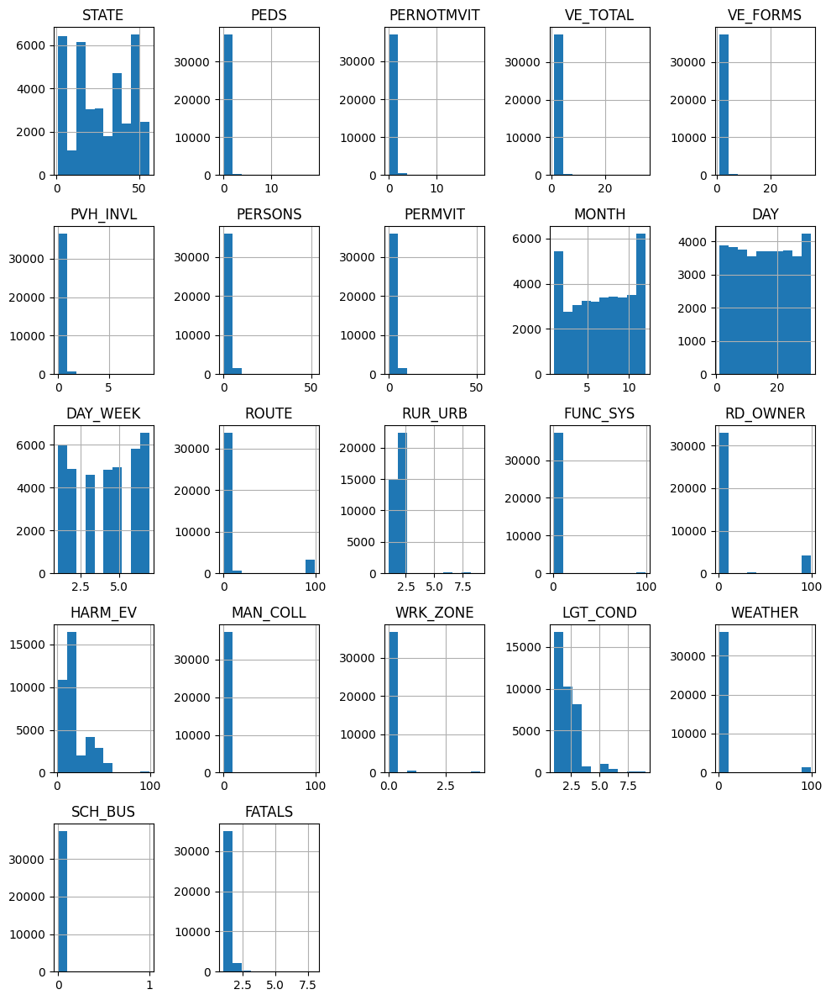

In [44]:
accidents_2.hist(figsize=(10,12))
plt.tight_layout()
plt.show()

Day vs day of the week: day = day of the month numerically  
Day is sun - sat (1-7)

# Unemployment Rates

In [12]:
files.upload()

Saving UnemploymentReport.csv to UnemploymentReport.csv


{'UnemploymentReport.csv': b'State,Name,2015,2016,2017,2018,2019,2020,2021,2022,2023,Median Household Income (2022)\r\n1,Alabama,6.1,5.9,4.5,3.9,3.2,6.4,3.4,2.5,2.5,"$59,703 "\r\n2,Alaska,6.3,6.6,6.5,6,5.6,8.3,6.4,4.2,4.2,"$88,072 "\r\n4,Arizona,6.1,5.5,5,4.8,4.8,7.8,5.1,3.8,3.9,"$74,355 "\r\n5,Arkansas,5,4,3.7,3.7,3.5,6.2,4,3.2,3.3,"$55,505 "\r\n6,California,6.3,5.5,4.8,4.2,4.1,10.1,7.3,4.3,4.8,"$91,517 "\r\n8,Colorado,3.7,3.1,2.6,3,2.7,6.8,5.5,3.1,3.2,"$89,096 "\r\n9,Connecticut,5.6,4.8,4.4,3.9,3.6,8,6.4,4.1,3.8,"$88,182 "\r\n10,Delaware,4.8,4.5,4.5,3.7,3.6,7.5,5.5,4.3,4,"$81,933 "\r\n11,District of Columbia,6.9,6.2,6.1,5.7,5.5,7.9,6.8,4.7,4.9,"$99,897 "\r\n12,Florida,5.5,4.9,4.3,3.6,3.3,8.1,4.7,3,2.9,"$69,287 "\r\n13,Georgia,6.1,5.4,4.8,4,3.6,6.5,3.9,3.1,3.2,"$72,742 "\r\n15,Hawaii,3.4,2.9,2.2,2.4,2.5,11.7,6,3.3,3,"$93,683 "\r\n16,Idaho,3.9,3.7,3.2,2.9,2.9,5.5,3.6,2.8,3.1,"$72,634 "\r\n17,Illinois,6,5.9,4.9,4.4,4,9.3,6.1,4.6,4.5,"$76,744 "\r\n18,Indiana,4.8,4.4,3.5,3.4,3.3,7.3,3.9,3

In [13]:
unemployment = pd.read_csv('UnemploymentReport.csv')
unemployment

#cleaned up this file so that the state numbers matched the accident file. I also took out Puerto Rico as I didnt have accident reports from here. I felt it wasnt needed.

,State,Name,2015,2016,2017,2018,2019,2020,2021,2022,2023,Median Household Income (2022)
0,1,Alabama,6.1,5.9,4.5,3.9,3.2,6.4,3.4,2.5,2.5,"$59,703"
1,2,Alaska,6.3,6.6,6.5,6.0,5.6,8.3,6.4,4.2,4.2,"$88,072"
2,4,Arizona,6.1,5.5,5.0,4.8,4.8,7.8,5.1,3.8,3.9,"$74,355"
3,5,Arkansas,5.0,4.0,3.7,3.7,3.5,6.2,4.0,3.2,3.3,"$55,505"
4,6,California,6.3,5.5,4.8,4.2,4.1,10.1,7.3,4.3,4.8,"$91,517"
5,8,Colorado,3.7,3.1,2.6,3.0,2.7,6.8,5.5,3.1,3.2,"$89,096"
6,9,Connecticut,5.6,4.8,4.4,3.9,3.6,8.0,6.4,4.1,3.8,"$88,182"
7,10,Delaware,4.8,4.5,4.5,3.7,3.6,7.5,5.5,4.3,4.0,"$81,933"
8,11,District of Columbia,6.9,6.2,6.1,5.7,5.5,7.9,6.8,4.7,4.9,"$99,897"
9,12,Florida,5.5,4.9,4.3,3.6,3.3,8.1,4.7,3.0,2.9,"$69,287"


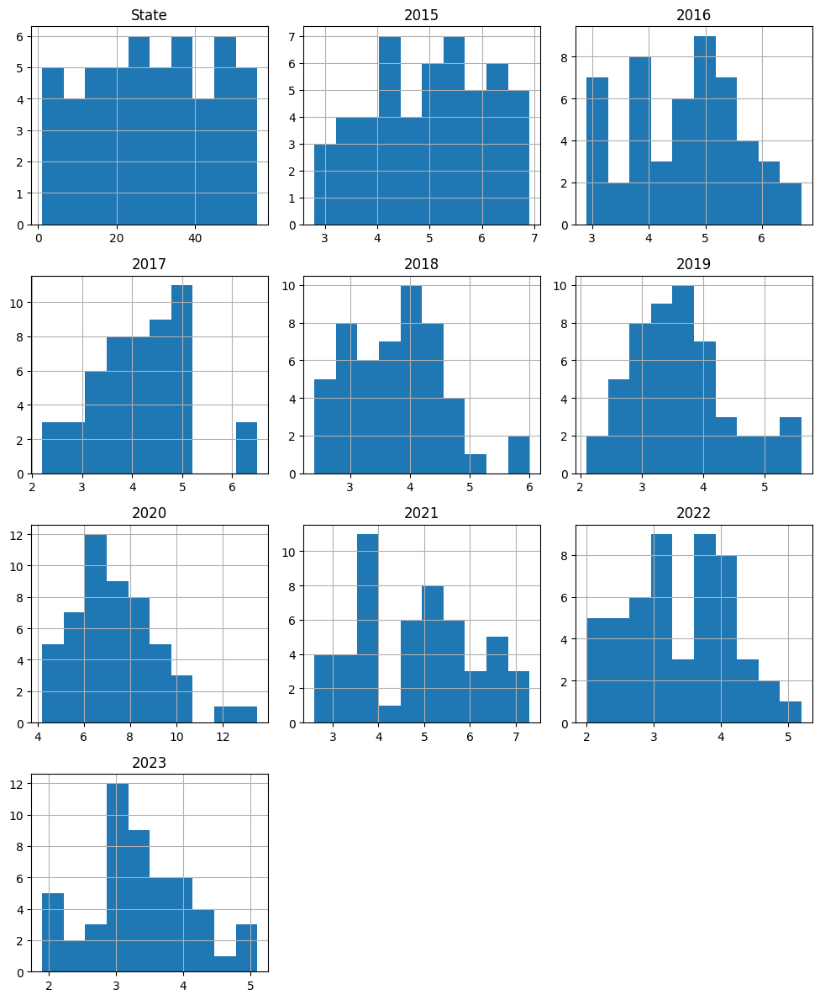

In [47]:
unemployment.hist(figsize=(10,12))
plt.tight_layout()
plt.show()

In [34]:
statekey = unemployment[['State','Name']]
statekey

,State,Name
0,1,Alabama
1,2,Alaska
2,4,Arizona
3,5,Arkansas
4,6,California
5,8,Colorado
6,9,Connecticut
7,10,Delaware
8,11,District of Columbia
9,12,Florida


In [14]:

unemployment.describe()

,State,2015,2016,2017,2018,2019,2020,2021,2022,2023
count,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000
mean,28.960784,5.011765,4.650980,4.158824,3.768627,3.582353,7.364706,4.831373,3.388235,3.335294
std,15.832828,1.101753,1.012398,0.927400,0.818655,0.827455,1.843347,1.257059,0.757535,0.758637
min,1.000000,2.800000,2.900000,2.200000,2.400000,2.100000,4.200000,2.600000,2.000000,1.900000
25%,16.500000,4.250000,3.950000,3.500000,3.100000,3.050000,6.200000,3.900000,2.800000,2.900000
50%,29.000000,5.100000,4.700000,4.300000,3.800000,3.500000,7.300000,4.900000,3.300000,3.200000
75%,41.500000,5.950000,5.350000,4.800000,4.200000,4.100000,8.250000,5.600000,4.000000,3.900000
max,56.000000,6.900000,6.700000,6.500000,6.000000,5.600000,13.500000,7.300000,5.200000,5.100000


<font color=skyblue>
We can see a rather large increase from 2019 - 2020. Its very obvious this was due to the pandemic. It more than doubled from all previous years but it did seem to correct itself in the following years  </font>

# Poverty Reports

In [16]:
files.upload()

Saving PovertyReport.csv to PovertyReport (1).csv


{'PovertyReport (1).csv': b'\xef\xbb\xbfState,Name,All Percent,All Lower Bound,All Upper Bound,Child Percent,Child Lower Bound,Child Upper Bound\r\n1,Alabama,15.7,15.3,16.1,21.3,20.5,22.1\r\n2,Alaska,10.5,9.9,11.1,12.5,11.4,13.6\r\n4,Arizona,12.6,12.3,12.9,15.8,15.1,16.5\r\n5,Arkansas,15.4,15,15.8,20.2,19.1,21.3\r\n6,California,12,11.9,12.1,15,14.6,15.4\r\n8,Colorado,9.4,9.1,9.7,10.9,10.1,11.7\r\n9,Connecticut,10.2,9.8,10.6,13,12.1,13.9\r\n10,Delaware,10.8,10.3,11.3,15.4,14.1,16.7\r\n11,District of Columbia,15.2,14.1,16.3,20.7,17.4,24\r\n12,Florida,12.4,12.2,12.6,16,15.4,16.6\r\n13,Georgia,13.7,13.4,14,18.8,18.1,19.5\r\n15,Hawaii,10.2,9.7,10.7,11.8,10.7,12.9\r\n16,Idaho,10.1,9.7,10.5,11.3,10.3,12.3\r\n17,Illinois,11.6,11.4,11.8,14.7,14.1,15.3\r\n18,Indiana,12.2,11.9,12.5,15.1,14.4,15.8\r\n19,Iowa,11.1,10.8,11.4,13,12.2,13.8\r\n20,Kansas,11.2,10.8,11.6,13.1,12.3,13.9\r\n21,Kentucky,16.1,15.8,16.4,20.2,19.3,21.1\r\n22,Louisiana,18.9,18.5,19.3,25.2,24.2,26.2\r\n23,Maine,10.5,10,11,12.6,11

#  2023 Report

In [17]:
poverty = pd.read_csv('PovertyReport.csv')
poverty

,State,Name,All Percent,All Lower Bound,All Upper Bound,Child Percent,Child Lower Bound,Child Upper Bound
0,1.0,Alabama,15.7,15.3,16.1,21.3,20.5,22.1
1,2.0,Alaska,10.5,9.9,11.1,12.5,11.4,13.6
2,4.0,Arizona,12.6,12.3,12.9,15.8,15.1,16.5
3,5.0,Arkansas,15.4,15.0,15.8,20.2,19.1,21.3
4,6.0,California,12.0,11.9,12.1,15.0,14.6,15.4
5,8.0,Colorado,9.4,9.1,9.7,10.9,10.1,11.7
6,9.0,Connecticut,10.2,9.8,10.6,13.0,12.1,13.9
7,10.0,Delaware,10.8,10.3,11.3,15.4,14.1,16.7
8,11.0,District of Columbia,15.2,14.1,16.3,20.7,17.4,24.0
9,12.0,Florida,12.4,12.2,12.6,16.0,15.4,16.6


Changed the column names to clean it up. All percents are 90% inverval estimate  
All = all people  
Child is ages 0-17

In [18]:
poverty.describe()

,State,All Percent,All Lower Bound,All Upper Bound,Child Percent,Child Lower Bound,Child Upper Bound
count,51.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000
mean,28.960784,12.201923,11.836538,12.567308,15.265385,14.367308,16.163462
std,15.832828,2.492144,2.480119,2.516278,3.972498,3.928564,4.063275
min,1.000000,7.300000,6.900000,7.700000,8.200000,7.100000,9.300000
25%,16.500000,10.275000,9.875000,10.675000,12.575000,11.500000,13.400000
50%,29.000000,11.850000,11.550000,12.100000,14.850000,14.050000,15.400000
75%,41.500000,13.700000,13.425000,13.925000,18.450000,17.525000,18.950000
max,56.000000,18.900000,18.500000,19.300000,25.200000,24.200000,26.200000


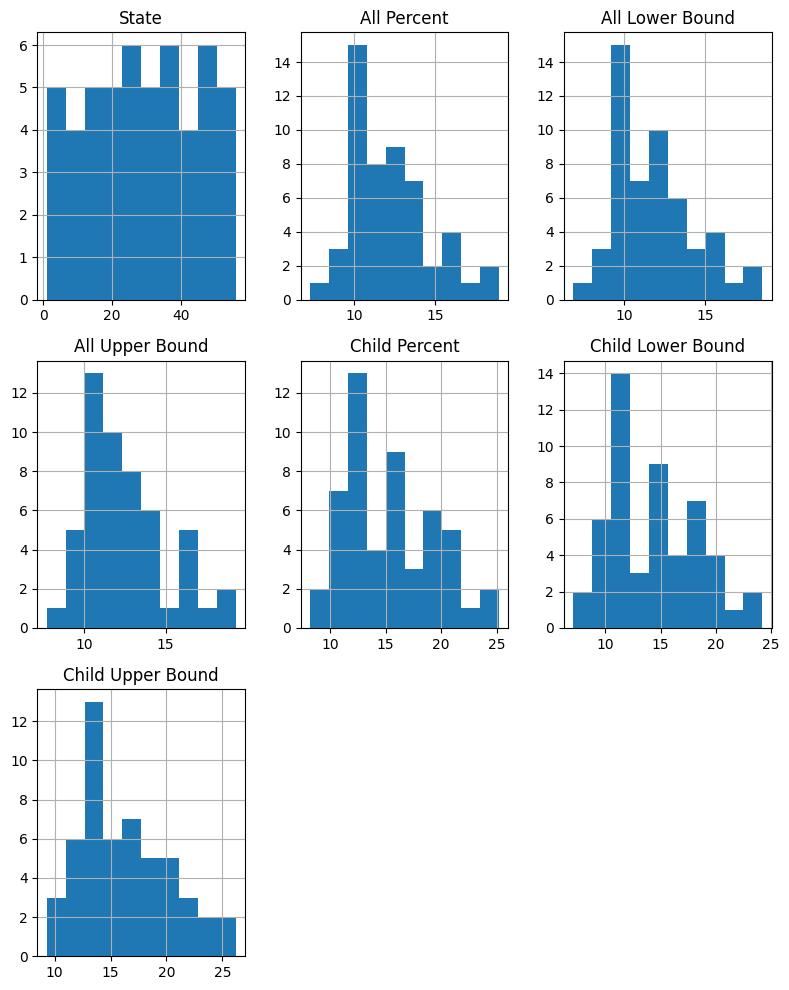

In [52]:
poverty.hist(figsize=(8,10))
plt.tight_layout()
plt.show()

# Population Report

In [20]:
files.upload()

Saving PopulationReport.csv to PopulationReport (1).csv


{'PopulationReport (1).csv': b'\xef\xbb\xbfState,Name,Pop. 1990,Pop. 2000,Pop. 2010,Pop. 2020,Pop. 2023,Change 2020-23\r\n0,United States,"248,790,925","281,424,600","308,758,105","331,464,948","334,914,895",1.00%\r\n1,Alabama,"4,040,389","4,447,207","4,780,118","5,024,294","5,108,468",1.70%\r\n2,Alaska,"550,043","626,933","710,246","733,374","733,406",0.00%\r\n4,Arizona,"3,665,339","5,130,247","6,392,292","7,157,902","7,431,344",3.80%\r\n5,Arkansas,"2,350,624","2,673,293","2,916,029","3,011,490","3,067,732",1.90%\r\n6,California,"29,811,427","33,871,653","37,254,522","39,538,212","38,965,193",-1.40%\r\n8,Colorado,"3,294,473","4,302,086","5,029,319","5,773,707","5,877,610",1.80%\r\n9,Connecticut,"3,287,116","3,405,650","3,574,151","3,605,912","3,617,176",0.30%\r\n10,Delaware,"666,168","783,559","897,947","989,946","1,031,890",4.20%\r\n11,District of Columbia,"606,900","572,086","601,767","689,548","678,972",-1.50%\r\n12,Florida,"12,938,071","15,982,571","18,804,589","21,538,216","22,61

In [21]:
population = pd.read_csv('PopulationReport.csv')
population

,State,Name,Pop. 1990,Pop. 2000,Pop. 2010,Pop. 2020,Pop. 2023,Change 2020-23
0,0,United States,"248,790,925","281,424,600","308,758,105","331,464,948","334,914,895",1.00%
1,1,Alabama,"4,040,389","4,447,207","4,780,118","5,024,294","5,108,468",1.70%
2,2,Alaska,"550,043","626,933","710,246","733,374","733,406",0.00%
3,4,Arizona,"3,665,339","5,130,247","6,392,292","7,157,902","7,431,344",3.80%
4,5,Arkansas,"2,350,624","2,673,293","2,916,029","3,011,490","3,067,732",1.90%
5,6,California,"29,811,427","33,871,653","37,254,522","39,538,212","38,965,193",-1.40%
6,8,Colorado,"3,294,473","4,302,086","5,029,319","5,773,707","5,877,610",1.80%
7,9,Connecticut,"3,287,116","3,405,650","3,574,151","3,605,912","3,617,176",0.30%
8,10,Delaware,"666,168","783,559","897,947","989,946","1,031,890",4.20%
9,11,District of Columbia,"606,900","572,086","601,767","689,548","678,972",-1.50%


I think I might move to Wyoming

In [22]:
population.describe()

,State
count,52.000000
mean,28.403846
std,16.183094
min,0.000000
25%,15.750000
50%,28.500000
75%,41.250000
max,56.000000


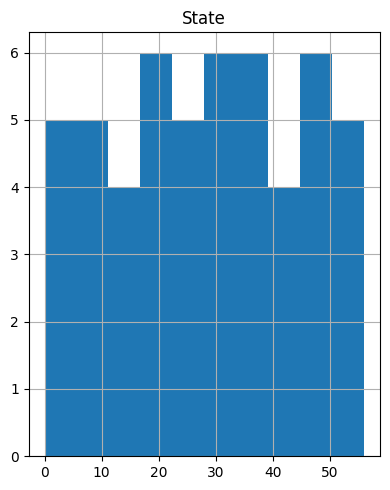

In [51]:
population.hist(figsize=(4, 5))
plt.tight_layout()
plt.show()